In [24]:
## Helper functions

import os
import sqlite3
from sqlite3 import Error
import gzip

def create_connection(db_file, delete_db=False):
    if delete_db and os.path.exists(db_file):
        os.remove(db_file)
    conn = None
    try:
        conn = sqlite3.connect(db_file)
        conn.execute("PRAGMA foreign_keys = 1")
    except Error as e:
        print(e)

    return conn


def create_table(conn, create_table_sql):
    try:
        c = conn.cursor()
        c.execute(create_table_sql)
    except Error as e:
        print(e)

In [25]:
# Creating project.db 
db_file = 'project.db'
conn = create_connection(db_file, delete_db=True)
conn.close()

In [26]:
def create_sql_table(db_file):
    # YOUR CODE HERE

    conn = create_connection(db_file)
    
    
    data_table="""CREATE TABLE [Housing_Data] (
                    [Tract] INTEGER PRIMARY KEY,
                    [Geo_ID1] Text,
                    [Geo_ID2] INTEGER,
                    [Total_Households] INTEGER,
                    [With_Computer] INTEGER,
                    [Commute_w_Public_Transp] INTEGER,
                    [Commute_by_Walking] INTEGER,
                    [Total_Household2] INTEGER,
                    [Household_Income_less_than_10] INTEGER,
                    [Household_Income_10_to_15] INTEGER,
                    [Household_Income_15_to_25] INTEGER,
                    [Household_Income_25_to_35] INTEGER,
                    [Household_Income_35_to_50] INTEGER,
                    [Household_Income_50_to_75] INTEGER,
                    [Household_Income_75_to_100] INTEGER,
                    [Household_Income_100_to_150] INTEGER,
                    [Household_Income_150_to_200] INTEGER,
                    [Household_Income_greater_than_200] INTEGER,
                    [Median_Household_Income] INTEGER,
                    [Civilians_aged_19_to_64] INTEGER,
                    [Civilians_aged_19_to_64_Employed] INTEGER,
                    [Total_Housing_Units] INTEGER,
                    [Number_of_Vacant_Units] INTEGER,
                    [Rental_Vacancy_Rate] INTEGER,
                    [Occupied_Housing_Units] INTEGER,
                    [Occupied_Housing_Units_Lacking_Full_Plumbing] INTEGER,
                    [Occupied_Housing_Units_Lacking_Full_Kitchen] INTEGER,
                    [Occupied_Housing_Units_No_Phone_Service] INTEGER,
                    [Median_Estimated_Value_of_Owner_Occupied_Units] INTEGER,
                    [Occupied_Housing_Units2] INTEGER,
                    [Occupied_Housing_Units_Owner_Occupied] INTEGER,
                    [Occupied_Housing_Units_Renter_Occupied] INTEGER,
                    [Occupied_Housing_Units3] INTEGER,
                    [Occupied_Units_with_No_Vehicles_Available] INTEGER,
                    [Gross_Rent_as_Percentage_of_Household_Income_less_than_15] INTEGER,
                    [Gross_Rent_as_Percentage_of_Household_Income_15_to_20] INTEGER,
                    [Gross_Rent_as_Percentage_of_Household_Income_20_to_25] INTEGER,
                    [Gross_Rent_as_Percentage_of_Household_Income_25_to_30] INTEGER,
                    [Gross_Rent_as_Percentage_of_Household_Income_30_to_35] INTEGER,
                    [Gross_Rent_as_Percentage_of_Household_Income_greater_than_35] INTEGER
                    );"""
    with conn:
        create_table(conn, data_table)

# create table
db_file = 'project.db'
create_sql_table(db_file)

In [27]:
import pandas as pd
db_file = 'project.db'
con = sqlite3.connect(db_file)
cursor = con.cursor()
q = "SELECT name FROM sqlite_master WHERE type = 'table';" #gives all the tables that are created
q2 = "SELECT * FROM Housing_Data"
pd.read_sql_query(q,con)

,name
0,Housing_Data


In [28]:
def read_file(filename):
    
    with open(filename, 'r') as filename1:
        my_list = []
        for i in filename1:
            my_list.append(i)
        for each in range(0, len(my_list)):
            my_list[each] = my_list[each].rstrip('\n')
            
        my_list.pop(0)
        my_list.pop(len(my_list)-1)
        my_list.pop(len(my_list)-1)
        new_list = []
        for each in range(0, len(my_list)):
            new_list.append(my_list[each].split(','))
    return(new_list)

In [29]:
# read_file('EAS503Project_Data2.csv')

In [30]:
def insert_data(conn, values):

    with conn:

        sql_info = '''INSERT INTO Housing_Data(Geo_ID1, Geo_ID2, Total_Households, With_Computer, Commute_w_Public_Transp, Commute_by_Walking, Total_Household2, Household_Income_less_than_10, Household_Income_10_to_15, Household_Income_15_to_25, Household_Income_25_to_35, Household_Income_35_to_50, Household_Income_50_to_75, Household_Income_75_to_100, Household_Income_100_to_150, Household_Income_150_to_200, Household_Income_greater_than_200, Median_Household_Income, Civilians_aged_19_to_64, Civilians_aged_19_to_64_Employed, Total_Housing_Units, Number_of_Vacant_Units, Rental_Vacancy_Rate, Occupied_Housing_Units, Occupied_Housing_Units_Lacking_Full_Plumbing, Occupied_Housing_Units_Lacking_Full_Kitchen, Occupied_Housing_Units_No_Phone_Service, Median_Estimated_Value_of_Owner_Occupied_Units, Occupied_Housing_Units2, Occupied_Housing_Units_Owner_Occupied, Occupied_Housing_Units_Renter_Occupied, Occupied_Housing_Units3, Occupied_Units_with_No_Vehicles_Available, Gross_Rent_as_Percentage_of_Household_Income_less_than_15, Gross_Rent_as_Percentage_of_Household_Income_15_to_20, Gross_Rent_as_Percentage_of_Household_Income_20_to_25, Gross_Rent_as_Percentage_of_Household_Income_25_to_30, Gross_Rent_as_Percentage_of_Household_Income_30_to_35, Gross_Rent_as_Percentage_of_Household_Income_greater_than_35)
                        VALUES(?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?)'''
        cur = conn.cursor()
        cur.execute(sql_info, values)    
        return cur.lastrowid

In [31]:
db_file = 'project.db'
conn = create_connection(db_file)

In [32]:
def populate_table(db_file, filename):
    conn = create_connection(db_file)
    with conn:
        data1 = read_file(filename)  #add this back in later

        for line in range(0, len(data1)): #len(data1)  #change back later .. remember not that many have values in the info field!!
            built_tup = tuple(data1[line])
            insert_data(conn, built_tup)
            
try:
    conn.close()
except:
    pass

db_file = 'project.db'
filename = 'EAS503Project_Data2.csv'
populate_table(db_file, filename)

In [33]:
import pandas as pd
db_file = 'project.db'
con = sqlite3.connect(db_file)
# cursor = con.cursor()
q = "SELECT name FROM sqlite_master WHERE type = 'table';" #gives all the tables that are created
q2 = "SELECT Tract, Rental_Vacancy_Rate FROM Housing_Data WHERE Median_Household_Income <30000 AND Rental_Vacancy_Rate > 0" #Median_Household_Income
q3 = "SELECT * FROM Housing_Data"
q4 = "SELECT Tract FROM Housing_Data WHERE Median_Household_Income <30000 AND Gross_Rent_as_Percentage_of_Household_Income_30_to_35 > "
pd.read_sql_query(q3,con)

,Tract,Geo_ID1,Geo_ID2,Total_Households,With_Computer,Commute_w_Public_Transp,Commute_by_Walking,Total_Household2,Household_Income_less_than_10,Household_Income_10_to_15,...,Occupied_Housing_Units_Owner_Occupied,Occupied_Housing_Units_Renter_Occupied,Occupied_Housing_Units3,Occupied_Units_with_No_Vehicles_Available,Gross_Rent_as_Percentage_of_Household_Income_less_than_15,Gross_Rent_as_Percentage_of_Household_Income_15_to_20,Gross_Rent_as_Percentage_of_Household_Income_20_to_25,Gross_Rent_as_Percentage_of_Household_Income_25_to_30,Gross_Rent_as_Percentage_of_Household_Income_30_to_35,Gross_Rent_as_Percentage_of_Household_Income_greater_than_35
0,1,1400000US36029000110,36029000110,1003,809,102,0,1003,76,99,...,535,468,1003,114,67,81,36,23,56,181
1,2,1400000US36029000200,36029000200,1687,1314,123,164,1687,200,138,...,791,896,1687,251,98,86,100,90,66,389
2,3,1400000US36029000500,36029000500,814,659,50,49,814,94,109,...,505,309,814,205,74,16,10,22,0,170
3,4,1400000US36029000600,36029000600,2050,1697,58,31,2050,188,89,...,1515,535,2050,142,164,140,10,46,23,92
4,5,1400000US36029000700,36029000700,1513,1300,86,41,1513,27,42,...,1158,355,1513,154,107,27,22,18,23,124
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,231,1400000US36029017300,36029017300,2832,2472,43,0,2832,104,181,...,2437,395,2832,114,51,14,32,64,38,177
231,232,1400000US36029017400,36029017400,1412,1085,147,23,1412,88,267,...,532,880,1412,364,117,104,97,140,19,333
232,233,1400000US36029017501,36029017501,677,469,0,5,677,94,53,...,421,256,677,93,24,0,33,26,43,94
233,234,1400000US36029017502,36029017502,956,720,2,23,956,21,54,...,827,129,956,38,22,51,0,5,0,27


In [34]:
# con = sqlite3.connect(db_file)
db_file = 'project.db'
conn = create_connection(db_file)
q2 = "SELECT Median_Household_Income FROM Housing_Data"

cur = conn.cursor()
cur.execute(q2)
tuples = cur.fetchall()
list1 = []
for each in range(0, len(tuples)):
    list1.append(tuples[each][0])


list1 = sorted(list1)
# print(list1)

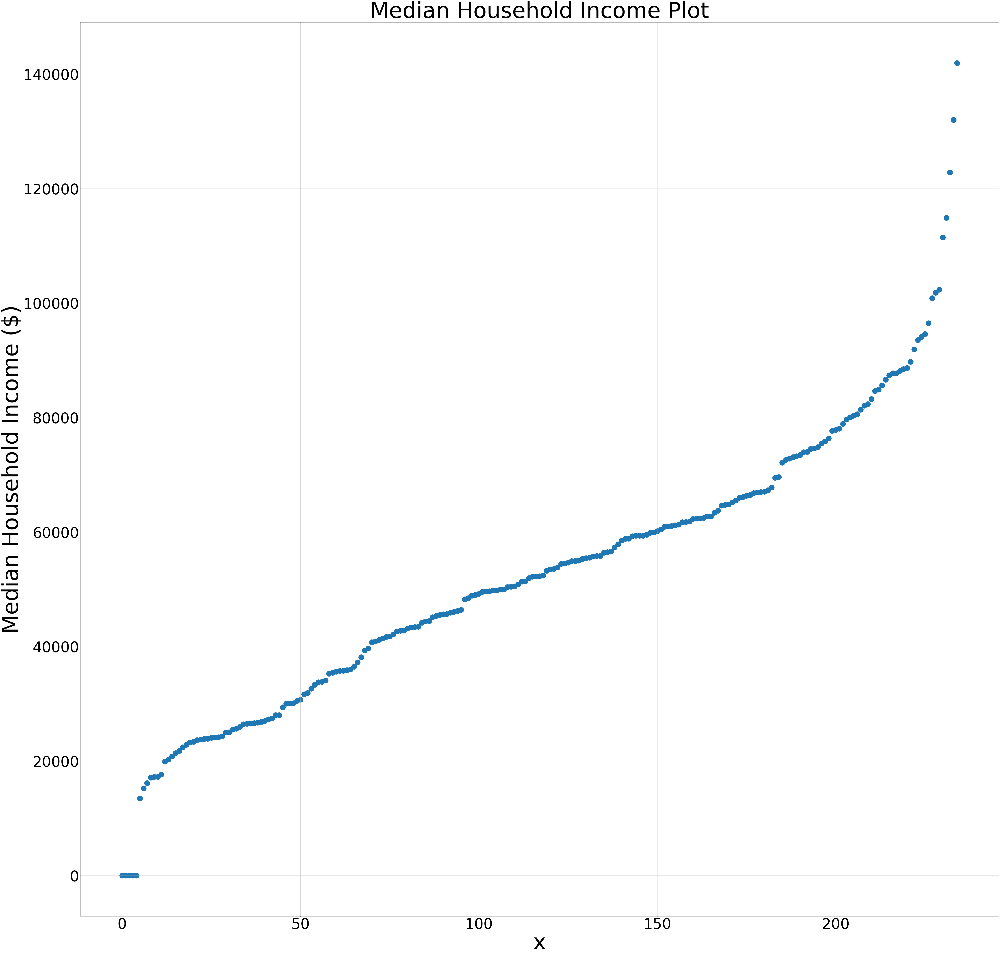

In [35]:
import numpy as np
import matplotlib.pyplot as plt
plt.figure(figsize=(90,90))
x = np.arange(len(list1))
y = list1
plt.scatter(x, y,s=30**2)
plt.xticks(fontsize=80)
plt.yticks(fontsize=80)
plt.title('Median Household Income Plot',fontsize=120)
plt.xlabel('x',fontsize=120)
plt.ylabel('Median Household Income ($)',fontsize=120)
plt.grid()
plt.show()

In [36]:
db_file = 'project.db'
conn = create_connection(db_file)
q2 = "SELECT Occupied_Units_with_No_Vehicles_Available FROM Housing_Data"
q3 = "SELECT Occupied_Housing_Units3 FROM Housing_Data"
cur = conn.cursor()
cur.execute(q2)
tuples = cur.fetchall()
list_veh= []
for each in range(0, len(tuples)):
    list_veh.append(tuples[each][0])
cur = conn.cursor()
cur.execute(q3)
tuples = cur.fetchall()
hh3= []
for each in range(0, len(tuples)):
    hh3.append(tuples[each][0])
#print(hh3)

for i in range(0, len(hh3)):
    if hh3[i]!=0:
        list_veh[i]=list_veh[i]/hh3[i]*100
    else:
        list_veh[i]=0
#print(list_veh)
#list1 = sorted(list1)



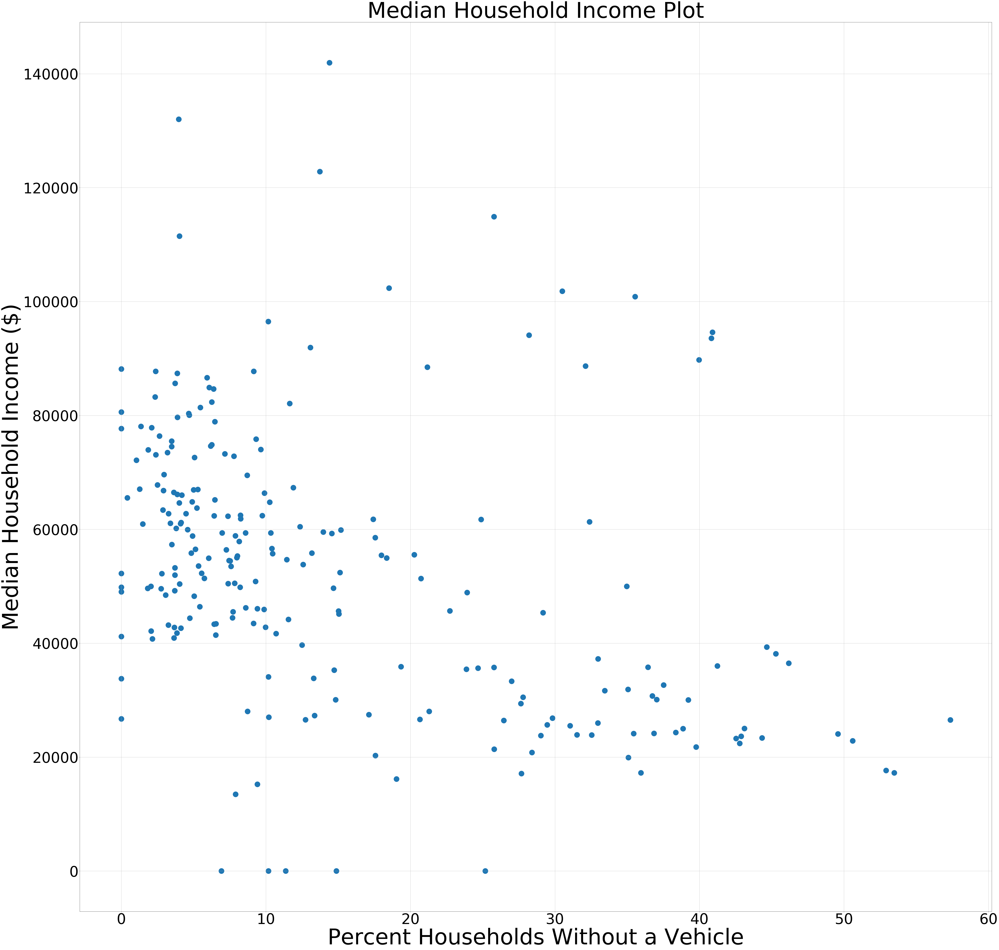

In [37]:
import numpy as np
import matplotlib.pyplot as plt
plt.figure(figsize=(90,90))
x = list_veh
y = list1
plt.scatter(x, y,s=30**2)
plt.xticks(fontsize=80)
plt.yticks(fontsize=80)
plt.title('Median Household Income Plot',fontsize=120)
plt.xlabel('Percent Households Without a Vehicle',fontsize=120)
plt.ylabel('Median Household Income ($)',fontsize=120)
plt.grid()
plt.show()

In [38]:
import pandas as pd
db_file = 'project.db'
con = sqlite3.connect(db_file)
query = "SELECT Tract FROM Housing_Data WHERE Median_Household_Income < 40000" #Tract would be diff col name
pd.read_sql_query(query,con)

,Tract
0,2
1,3
2,9
3,10
4,11
...,...
65,228
66,229
67,232
68,233


In [39]:
import numpy as np
# income_weights = [[1,2,3], [1,2,3],]

# db_file = 'project.db'
# conn = create_connection(db_file)
# query = "SELECT Tract, Predictor FROM Housing_Data WHERE Median_Household_Income < 40000" #Tract would be diff col name

# cur = conn.cursor()
# cur.execute(query)
# tuples = cur.fetchall()
# list1 = []
# tract_num = []

# for each in range(0, len(tuples)):
#     list1.append(tuples[each][0])
#     tract_num.append(tuples[each][1])
# # print(list1)


# scores = np.zeros(len(list1))


# for each in list1:
#     score[each] = score[each] + (list1[each]*low_income_weights[0])
    
# for each in list2:
#     score[each] = score[each] + (list1[each]*low_income_weights[1])
    
# new = []
# for each in range(0, len(score)):
#     new.append([tract_num[each], score[each]])
    



In [40]:
# income_weights = [[0.5,.5,.5],[1,0,0],[1,0,0],[.5,0,-.5],[-1,-1,-1],[-.5,-.5,-.5],[1,.5,0],[-1,0,1],[-.5,1,2],[0,1.5,1],[1,1.5,.5],[2,1,0],[.5,0,-1]]
# scores = np.zeros(237)
# for key in dictionary.keys():
    
#     if dictionary[key] < 40000:
        
#     elif dictionary[key] > 70000:
        
#     else:


In [41]:
db_file = 'project.db'
conn = create_connection(db_file)
q2 = "SELECT Median_Household_Income FROM Housing_Data"

cur = conn.cursor()
cur.execute(q2)
tuples = cur.fetchall()
list1 = []
for each in range(0, len(tuples)):
    list1.append(tuples[each][0])


In [42]:
db_file = 'project.db'
conn = create_connection(db_file)

q1 = "SELECT Total_Households FROM Housing_Data"
q2 = "SELECT With_Computer FROM Housing_Data"
q3 = "SELECT Commute_w_Public_Transp FROM Housing_Data"
q4 = "SELECT Commute_by_Walking FROM Housing_Data"
q5 = "SELECT Total_Housing_Units FROM Housing_Data"
q6 = "SELECT Number_of_Vacant_Units FROM Housing_Data"
q7 = "SELECT Occupied_Housing_Units FROM Housing_Data"
q8 = "SELECT Occupied_Housing_Units_Lacking_Full_Plumbing FROM Housing_Data"
q9 = "SELECT Occupied_Housing_Units_No_Phone_Service FROM Housing_Data"
q10 = "SELECT Occupied_Housing_Units2 FROM Housing_Data"
q11= "SELECT Occupied_Housing_Units_Renter_Occupied FROM Housing_Data"
q12= "SELECT Occupied_Housing_Units3 FROM Housing_Data"
q13= "SELECT Gross_Rent_as_Percentage_of_Household_Income_less_than_15 FROM Housing_Data"
q14= "SELECT Gross_Rent_as_Percentage_of_Household_Income_15_to_20 FROM Housing_Data"
q15= "SELECT Gross_Rent_as_Percentage_of_Household_Income_20_to_25 FROM Housing_Data"
q16= "SELECT Gross_Rent_as_Percentage_of_Household_Income_25_to_30 FROM Housing_Data"
q17= "SELECT Gross_Rent_as_Percentage_of_Household_Income_30_to_35 FROM Housing_Data"
q18= "SELECT Gross_Rent_as_Percentage_of_Household_Income_greater_than_35 FROM Housing_Data"

#lists:
h1=[]
computers=[] #q2
pub_trans=[] #q3
walkers=[] #q4
h2=[]
vac=[] #q6
h3=[]
no_plumb=[] #q8
no_phone=[] #q9
h4=[]
rent_occ=[] #q11
h5=[]
less_15=[] #q13
per_15to20=[] #q14
per_20to25=[] #q15
per_25to30=[] #q16
per_30to35=[] #q17
over_35=[] #q18

cur = conn.cursor()
cur.execute(q1)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    h1.append(tuples[each][0])
cur.execute(q2)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    computers.append(tuples[each][0])
length=len(computers)
for i in range(0, length):
    if h1[i]!=0:
        computers[i]=computers[i]/h1[i]
    else:
        computers[i]=0

cur.execute(q3)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    pub_trans.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        pub_trans[i]=pub_trans[i]/h1[i]
    else:
        pub_trans[i]=0

cur.execute(q4)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    walkers.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        walkers[i]=walkers[i]/h1[i]
    else:
        walkers[i]=0
#print(walkers)        
cur.execute(q5)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    h2.append(tuples[each][0])
cur.execute(q6)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    vac.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        vac[i]=vac[i]/h2[i]
    else:
        vac[i]=0

cur.execute(q7)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    h3.append(tuples[each][0])
cur.execute(q8)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    no_plumb.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        no_plumb[i]=no_plumb[i]/h3[i]
    else:
        no_plumb[i]=0

cur.execute(q9)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    no_phone.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        no_phone[i]=no_phone[i]/h3[i]
    else:
        no_phone[i]=0

cur.execute(q10)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    h4.append(tuples[each][0])
cur.execute(q11)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    rent_occ.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        rent_occ[i]=rent_occ[i]/h4[i]
    else:
        rent_occ[i]=0

cur.execute(q12)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    h5.append(tuples[each][0])
cur.execute(q13)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    less_15.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        less_15[i]=less_15[i]/h5[i]
    else:
        less_15[i]=0
        
cur.execute(q14)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    per_15to20.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        per_15to20[i]=per_15to20[i]/h5[i]
    else:
        per_15to20[i]=0
        
cur.execute(q15)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    per_20to25.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        per_20to25[i]=per_20to25[i]/h5[i]
    else:
        per_20to25[i]=0

cur.execute(q16)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    per_25to30.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        per_25to30[i]=per_25to30[i]/h5[i]
    else:
        per_25to30[i]=0

cur.execute(q17)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    per_30to35.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        per_30to35[i]=per_30to35[i]/h5[i]
    else:
        per_30to35[i]=0

cur.execute(q18)
tuples = cur.fetchall()
for each in range(0, len(tuples)):
    over_35.append(tuples[each][0])
for i in range(0, length):
    if h1[i]!=0:
        over_35[i]=over_35[i]/h5[i]
    else:
        over_35[i]=0

# print(over_35)

pred_dict={}
pred_list=[]
for p in range(0,len(list1)):
    pred_list.append(computers[p])
    pred_list.append(pub_trans[p]) 
    pred_list.append(walkers[p])
    pred_list.append(vac[p])
    pred_list.append(no_plumb[p])
    pred_list.append(no_phone[p])
    pred_list.append(rent_occ[p])
    pred_list.append(less_15[p])
    pred_list.append(per_15to20[p])
    pred_list.append(per_20to25[p])
    pred_list.append(per_25to30[p])
    pred_list.append(per_30to35[p])
    pred_list.append(over_35[p])
    pred_dict[list1[p]]=pred_list
    pred_list=[]
pred_dict

{41194: [0.806580259222333,
  0.1016949152542373,
  0.0,
  0.16137123745819398,
  0.0,
  0.0,
  0.4666001994017946,
  0.06679960119641076,
  0.08075772681954138,
  0.03589232303090728,
  0.022931206380857428,
  0.05583250249252243,
  0.18045862412761715],
 31682: [0.7788974510966212,
  0.07291049199762893,
  0.0972139893301719,
  0.12318087318087319,
  0.01066982809721399,
  0.00948429164196799,
  0.5311203319502075,
  0.058091286307053944,
  0.05097806757557795,
  0.05927682276229994,
  0.053349140486069944,
  0.03912270302311796,
  0.23058684054534678],
 27012: [0.8095823095823096,
  0.06142506142506143,
  0.060196560196560195,
  0.23424270931326435,
  0.0,
  0.007371007371007371,
  0.3796068796068796,
  0.09090909090909091,
  0.019656019656019656,
  0.012285012285012284,
  0.02702702702702703,
  0.0,
  0.20884520884520885],
 55548: [0.8278048780487804,
  0.02829268292682927,
  0.015121951219512195,
  0.05224225612575127,
  0.005853658536585366,
  0.03414634146341464,
  0.26097560975

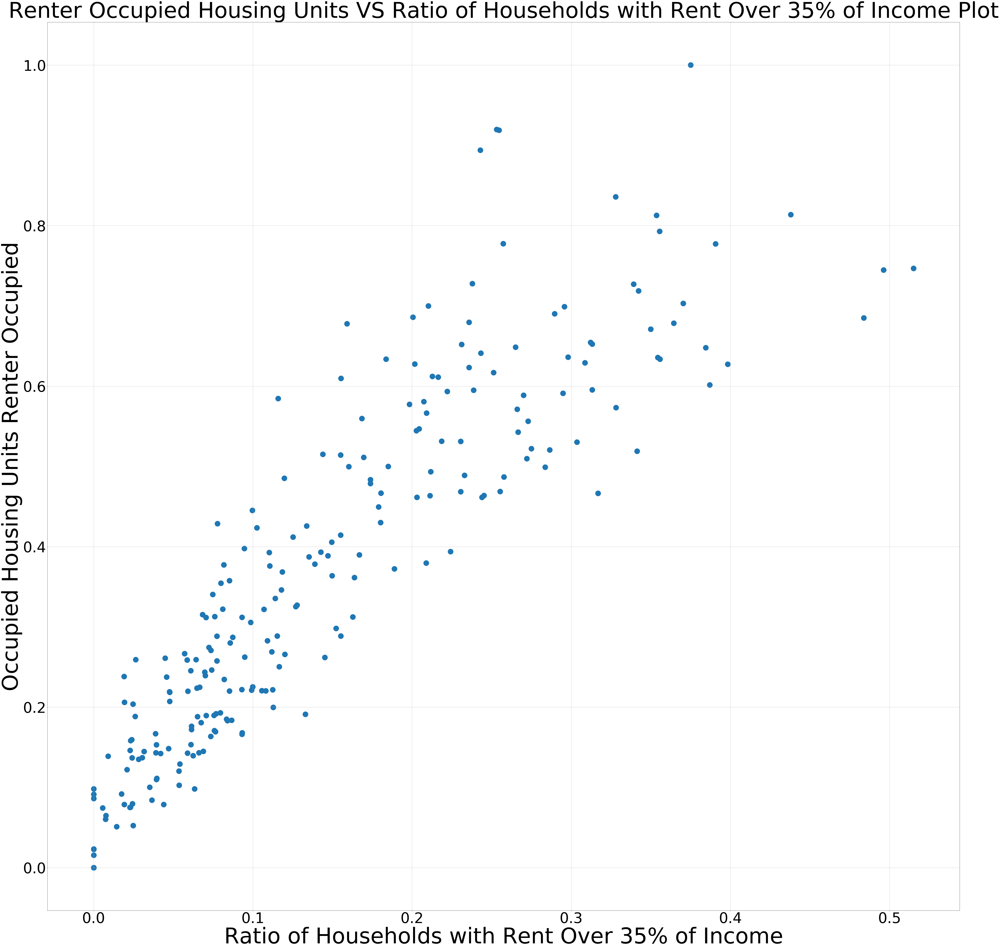

In [46]:
plt.figure(figsize=(90,90))
x = over_35
y = rent_occ
plt.scatter(x, y,s=30**2)
plt.xticks(fontsize=80)
plt.yticks(fontsize=80)
plt.title('Renter Occupied Housing Units VS Ratio of Households with Rent Over 35% of Income Plot',fontsize=120)
plt.xlabel('Ratio of Households with Rent Over 35% of Income',fontsize=120)
plt.ylabel('Occupied Housing Units Renter Occupied',fontsize=120)
plt.grid()
plt.show()

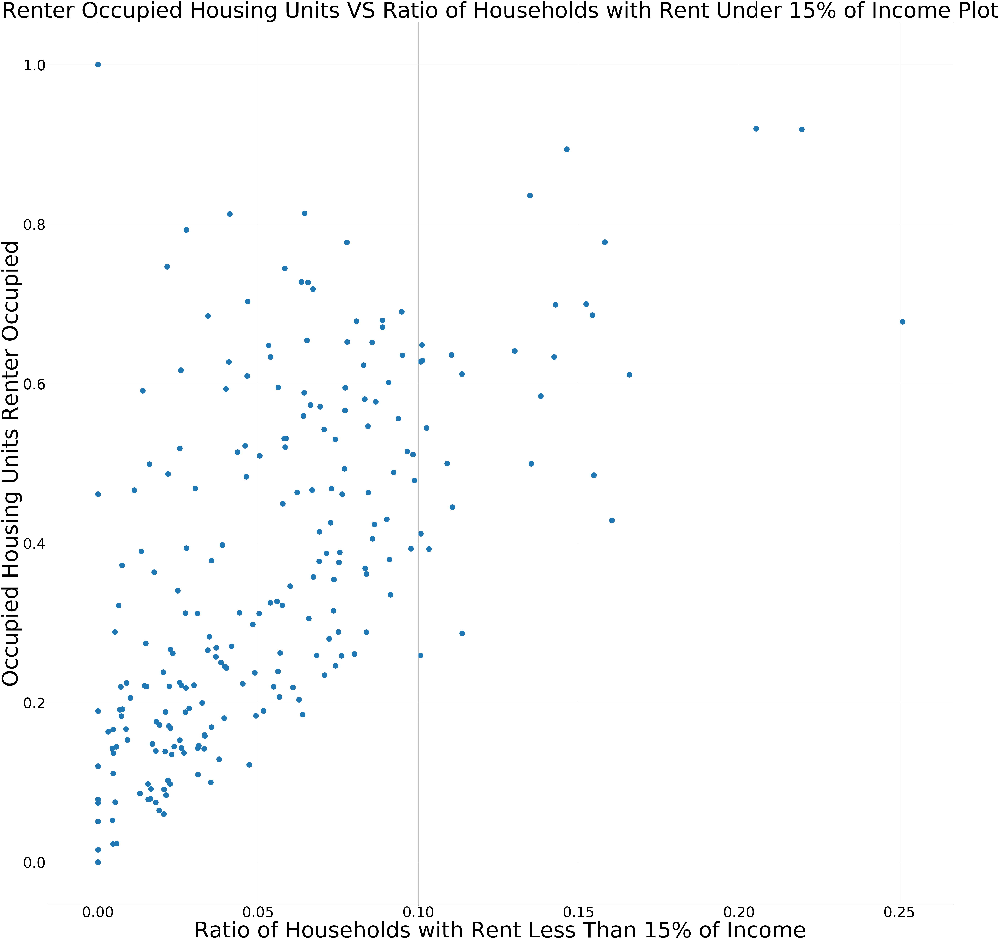

In [53]:
plt.figure(figsize=(90,90))
x = less_15
y = rent_occ
plt.scatter(x, y,s=30**2)
plt.xticks(fontsize=80)
plt.yticks(fontsize=80)
plt.title('Renter Occupied Housing Units VS Ratio of Households with Rent Under 15% of Income Plot',fontsize=120)
plt.xlabel('Ratio of Households with Rent Less Than 15% of Income',fontsize=120)
plt.ylabel('Occupied Housing Units Renter Occupied',fontsize=120)
plt.grid()
plt.show()

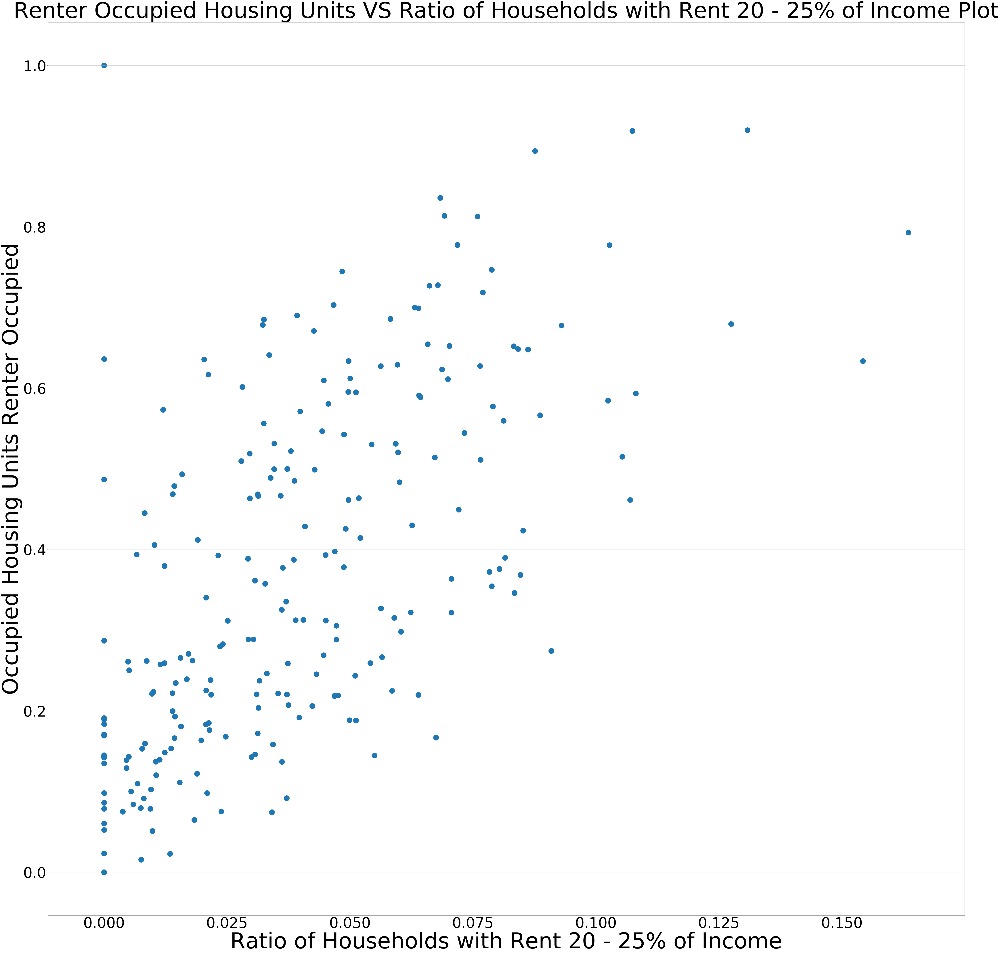

In [51]:
plt.figure(figsize=(90,90))
x = per_20to25
y = rent_occ
plt.scatter(x, y,s=30**2)
plt.xticks(fontsize=80)
plt.yticks(fontsize=80)
plt.title('Renter Occupied Housing Units VS Ratio of Households with Rent 20 - 25% of Income Plot',fontsize=120)
plt.xlabel('Ratio of Households with Rent 20 - 25% of Income',fontsize=120)
plt.ylabel('Occupied Housing Units Renter Occupied',fontsize=120)
plt.grid()
plt.show()

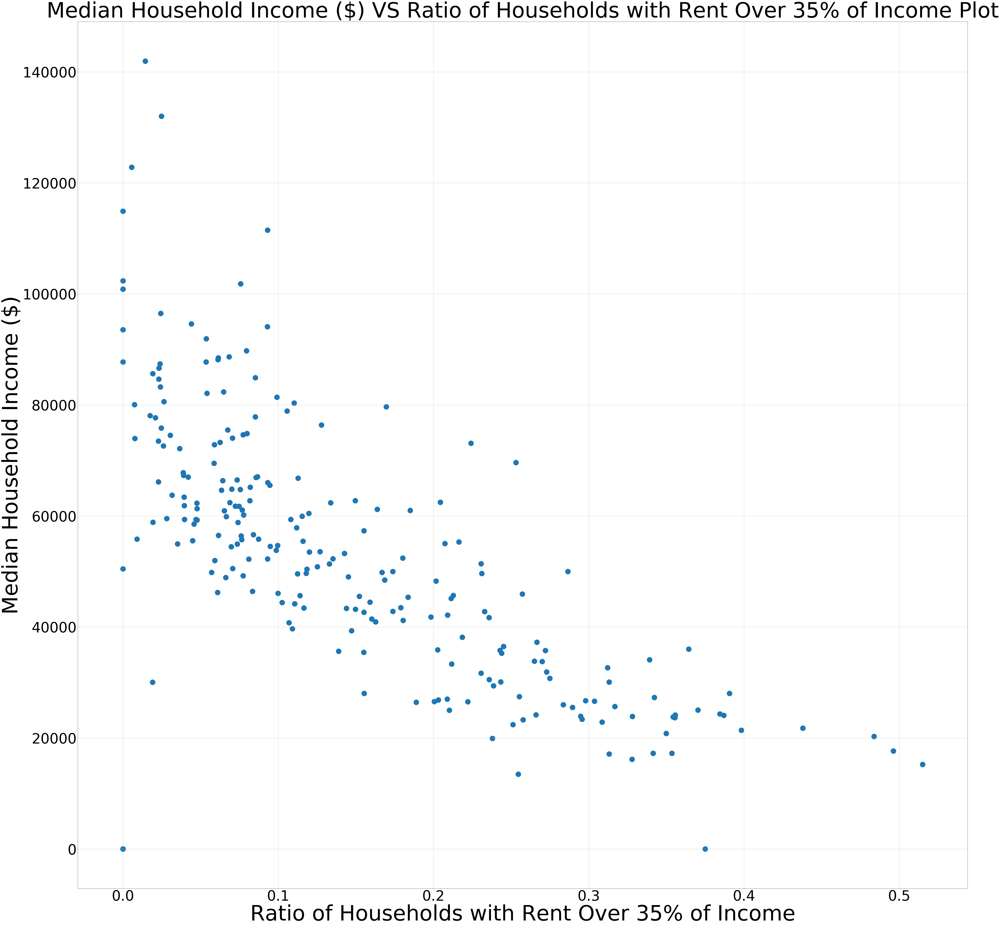

In [54]:
plt.figure(figsize=(90,90))
x = over_35
y = list1
plt.scatter(x, y,s=30**2)
plt.xticks(fontsize=80)
plt.yticks(fontsize=80)
plt.title('Median Household Income ($) VS Ratio of Households with Rent Over 35% of Income Plot',fontsize=120)
plt.xlabel('Ratio of Households with Rent Over 35% of Income',fontsize=120)
plt.ylabel('Median Household Income ($)',fontsize=120)
plt.grid()
plt.show()

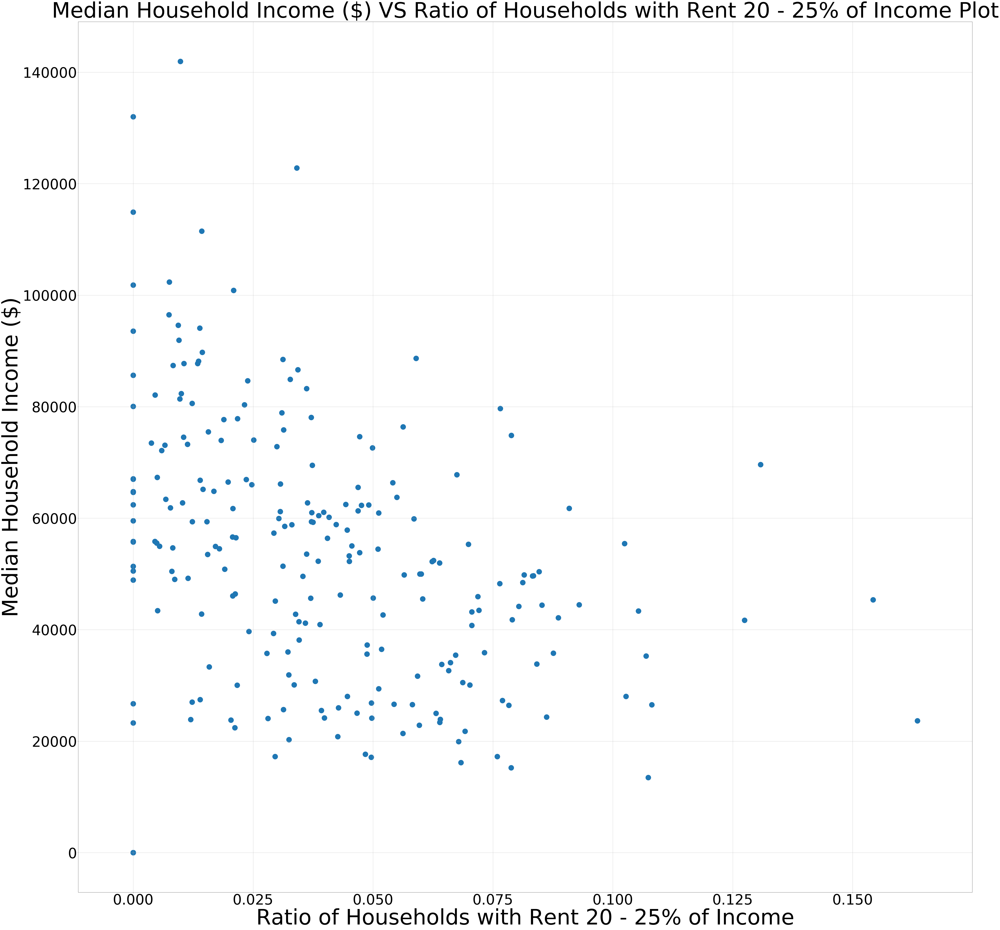

In [55]:
plt.figure(figsize=(90,90))
x = per_20to25
y = list1
plt.scatter(x, y,s=30**2)
plt.xticks(fontsize=80)
plt.yticks(fontsize=80)
plt.title('Median Household Income ($) VS Ratio of Households with Rent 20 - 25% of Income Plot',fontsize=120)
plt.xlabel('Ratio of Households with Rent 20 - 25% of Income',fontsize=120)
plt.ylabel('Median Household Income ($)',fontsize=120)
plt.grid()
plt.show()

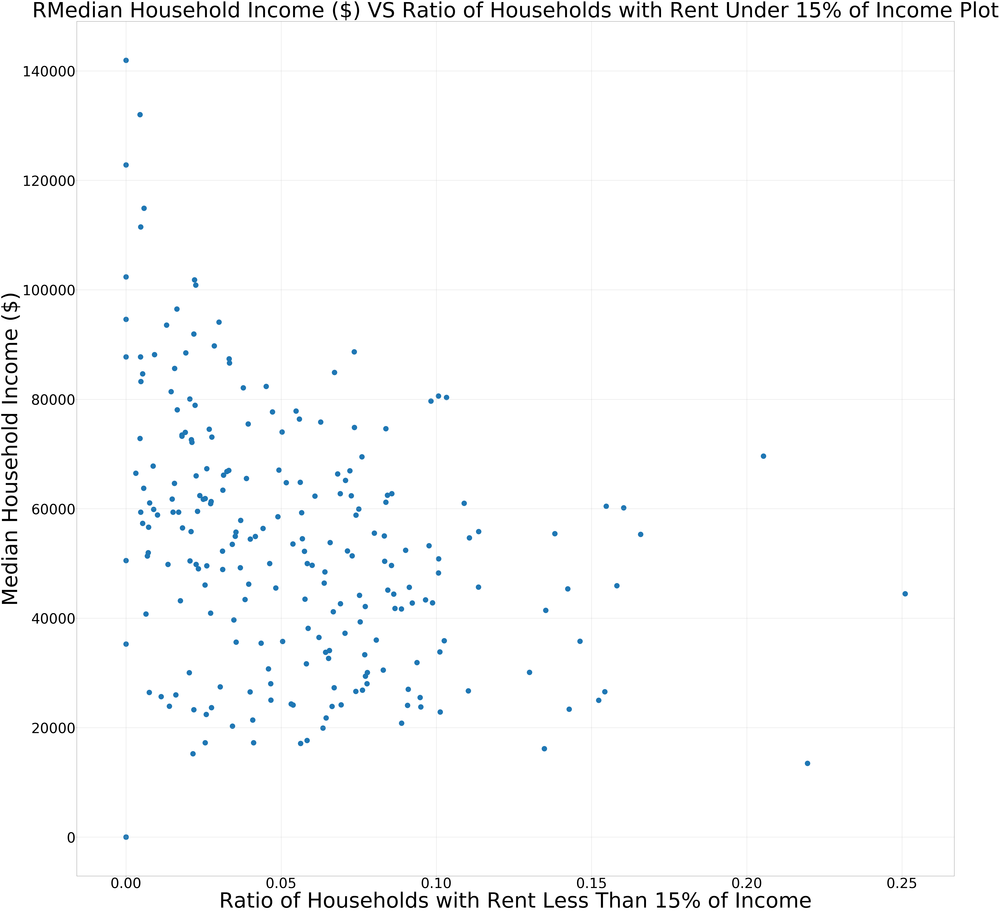

In [56]:
plt.figure(figsize=(90,90))
x = less_15
y = list1
plt.scatter(x, y,s=30**2)
plt.xticks(fontsize=80)
plt.yticks(fontsize=80)
plt.title('RMedian Household Income ($) VS Ratio of Households with Rent Under 15% of Income Plot',fontsize=120)
plt.xlabel('Ratio of Households with Rent Less Than 15% of Income',fontsize=120)
plt.ylabel('Median Household Income ($)',fontsize=120)
plt.grid()
plt.show()

In [27]:
dictionary = pred_dict
income_weights = [[0.5,.5,.5],[1,0,0],[1,0,0],[.5,0,-.5],[-1,-1,-1],[-.5,-.5,-.5],[1,.5,0],[-1,0,1],[-.5,1,2],[0,1.5,1],[1,1.5,.5],[2,1,0],[.5,0,-1]]

low_scores = []
for key in dictionary.keys():
    i = 0
    temp_scores = []
    for each in range(0, len(income_weights)):
        temp_scores.append(dictionary[key][each]*income_weights[each][i])
    low_scores.append(sum(temp_scores))
    temp_scores=[]
# print(low_scores)


md_scores = []
for key in dictionary.keys():
    i = 1
    temp_scores = []
    for each in range(0, len(income_weights)):
        temp_scores.append(dictionary[key][each]*income_weights[each][i])
    md_scores.append(sum(temp_scores))
    temp_scores=[]
# print(md_scores)


high_scores = []
for key in dictionary.keys():
    i = 2
    temp_scores = []
    for each in range(0, len(income_weights)):
        temp_scores.append(dictionary[key][each]*income_weights[each][i])
    high_scores.append(sum(temp_scores))
    temp_scores=[]
# print(high_scores)



In [28]:
# print(sorted(scores))

In [29]:
import pandas as pd 

db_file = 'project.db'
conn = create_connection(db_file)
q2 = "SELECT Geo_ID2 FROM Housing_Data WHERE Median_Household_Income <> 0"

cur = conn.cursor()
cur.execute(q2)
tuples = cur.fetchall()
geo = []
for each in range(0, len(tuples)):
    geo.append(tuples[each][0])

# len(geo)
# intialise data of lists. 
data = {'geo_id': geo, 'low':low_scores, 'med':md_scores, 'high': high_scores} 
  
# Create DataFrame 
df = pd.DataFrame(data) 
  
# Print the output. 
df 

,geo_id,low,med,high
0,36029000110,1.169918,0.861416,0.417819
1,36029000200,1.300180,0.898637,0.327858
2,36029000500,1.050168,0.669533,0.231159
3,36029000600,0.674658,0.641951,0.552659
4,36029000700,0.792290,0.615003,0.424828
...,...,...,...,...
225,36029017300,0.667595,0.566208,0.389785
226,36029017400,1.262091,1.004603,0.426649
227,36029017501,0.950265,0.720089,0.272778
228,36029017502,0.557524,0.494770,0.409527


In [35]:
from matplotlib.collections import PatchCollection
import geopandas as gpd
import numpy as np
from matplotlib import cm
import matplotlib.pyplot as plt
fp = 'tl_2017_36029_faces.shp'

In [66]:
buff = gpd.read_file(fp)
buff.head()
buff['geo_id'] = buff['STATEFP10'].map(str)+buff['COUNTYFP10'].map(str)+buff['TRACTCE10'].map(str)
buff['geo_id'] = buff['geo_id'].astype('int64')
buff.geo_id.dtype

dtype('int64')

In [67]:
buff = pd.merge(buff,df, how = 'inner', on = 'geo_id')

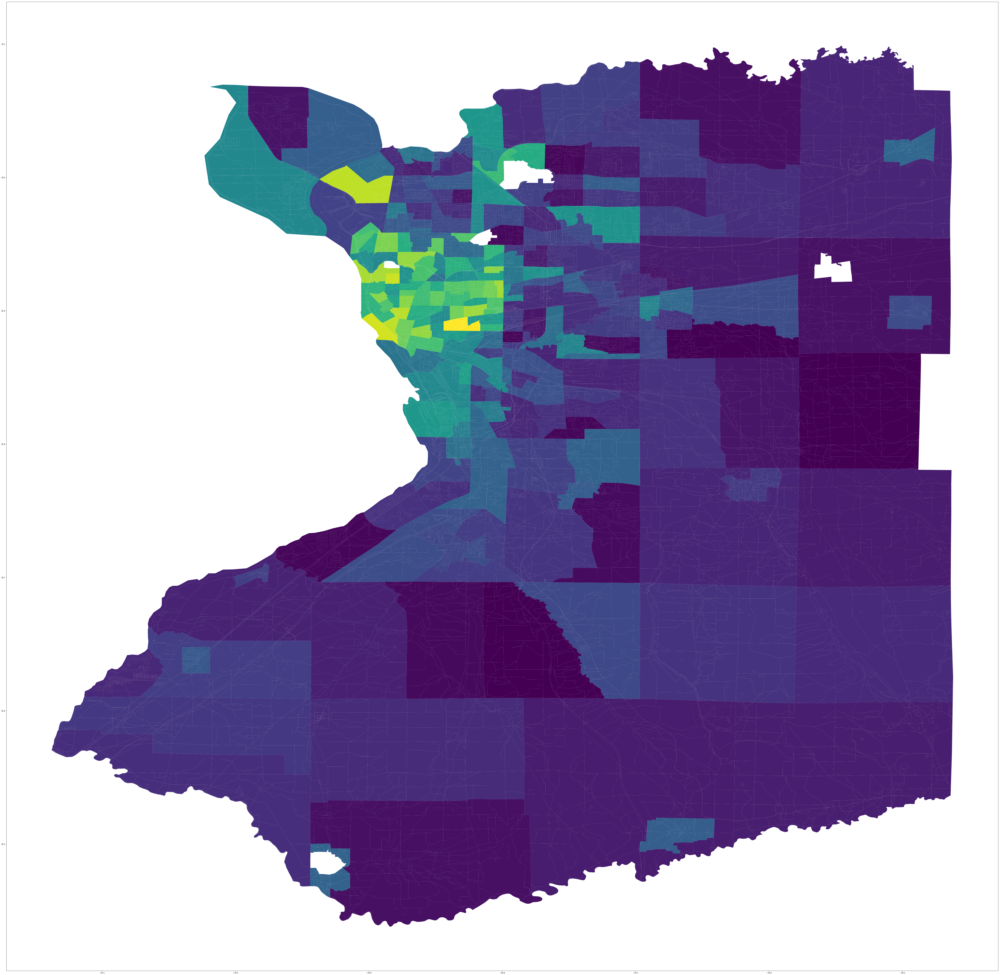

In [72]:
buff.plot(cmap = "viridis", column = "low", figsize = (100,100))

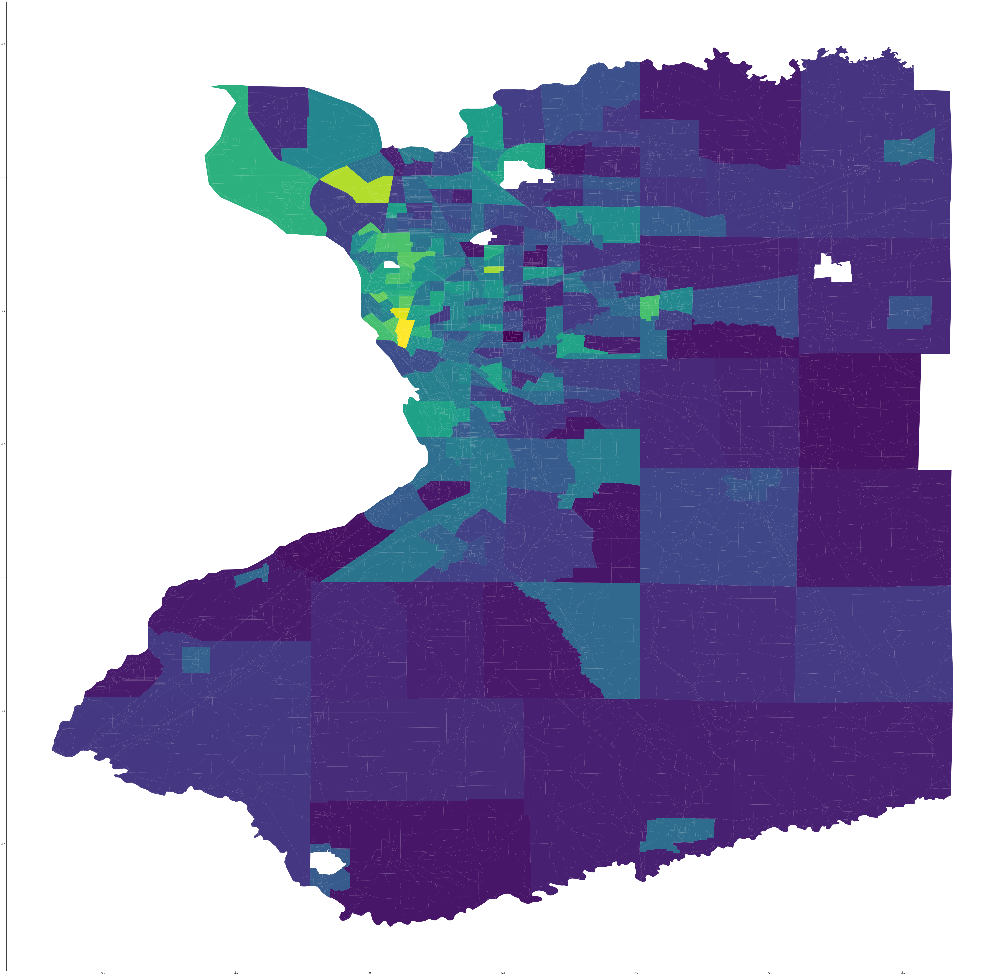

In [73]:
buff.plot(cmap = "viridis", column = "med", figsize = (100,100))

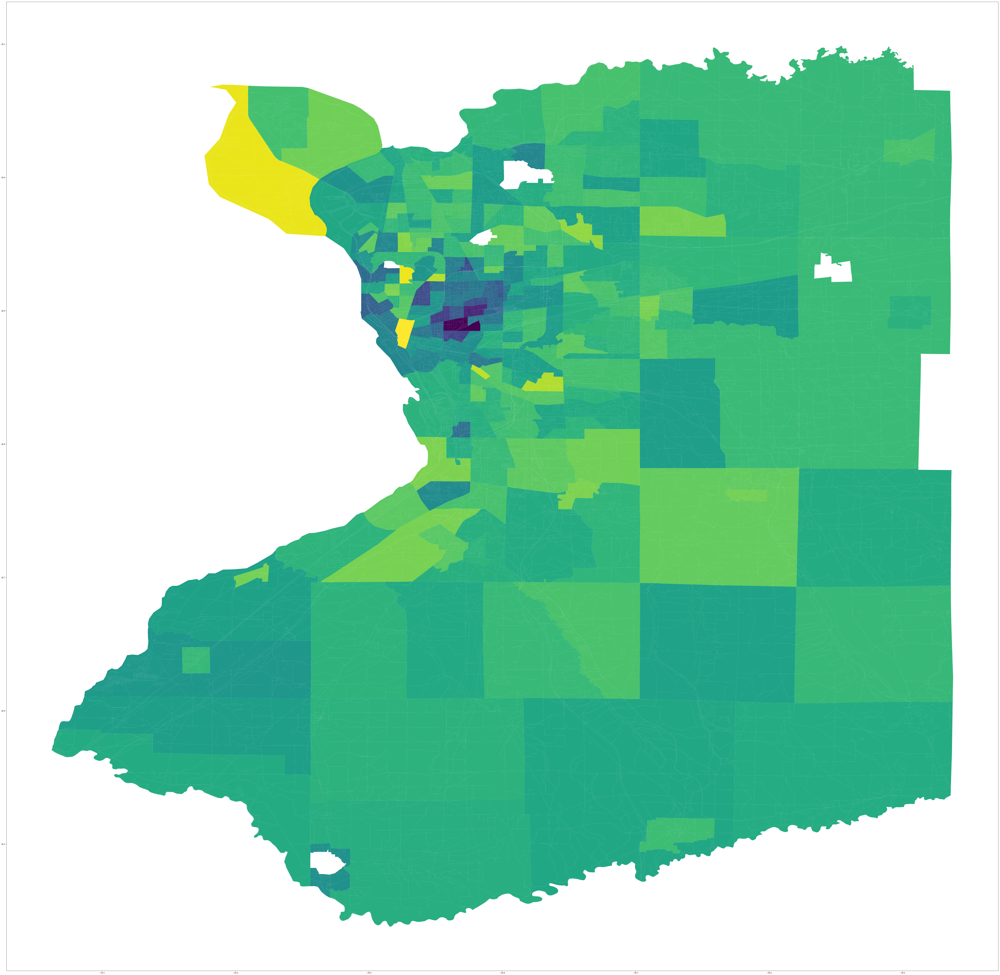

In [74]:
buff.plot(cmap = "viridis", column = "high", figsize = (100,100))